In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df=pd.read_csv(r"C:\workspace\smart energy\usecase\energy_consumtion_prediction\prediction_machinelearning_dataset\energy_consumption_data.csv")

In [3]:
df.head()

,timestamp,energy_consumption,building_id,apparent_temperature,air_temperature,dew_point_temperature,relative_humidity,wind_speed,wind_direction,month,day,hour,weekday,building_category,is_weekend,season,is_holiday
0,2020-01-01 00:00:00,5.8438,1.0,18.2083,20.0417,9.4000,50.2833,8.7933,159.6167,1,1,0,2,library,0,summer,1.0
1,2020-01-01 01:00:00,7.5312,1.0,17.2317,19.0067,9.0683,52.5000,8.1167,157.8667,1,1,1,2,library,0,summer,1.0
2,2020-01-01 02:00:00,7.5312,1.0,16.9167,18.9767,8.9700,52.2833,9.4600,152.4000,1,1,2,2,library,0,summer,1.0
3,2020-01-01 03:00:00,8.0625,1.0,15.7317,17.5467,8.5250,55.4167,7.5700,183.2000,1,1,3,2,library,0,summer,1.0
4,2020-01-01 04:00:00,7.6250,1.0,15.0667,16.4633,8.7233,60.1000,5.6700,190.9500,1,1,4,2,library,0,summer,1.0


# Data Analysis

In [4]:
df.describe()

,energy_consumption,building_id,apparent_temperature,air_temperature,dew_point_temperature,relative_humidity,wind_speed,wind_direction,month,day,hour,weekday,is_weekend,is_holiday
count,79056.000000,79056.000000,78957.000000,78957.000000,78957.000000,78957.000000,78957.000000,78957.000000,79056.000000,79056.000000,79056.00000,79056.000000,79056.000000,79056.000000
mean,15.089880,5.000000,13.792473,15.587136,9.011858,71.434345,8.869911,173.646959,6.513661,15.756831,11.50000,2.997268,0.284153,0.002732
std,20.483902,2.582005,7.942480,7.874472,4.321807,24.758121,7.207867,87.842718,3.451256,8.811585,6.92223,1.995224,0.451013,0.052200
min,0.000000,1.000000,-4.081700,-1.378300,-9.681700,3.616700,0.000000,0.000000,1.000000,1.000000,0.00000,0.000000,0.000000,0.000000
25%,2.794000,3.000000,7.671700,9.616700,6.085000,52.950000,2.750000,106.200000,4.000000,8.000000,5.75000,1.000000,0.000000,0.000000
50%,7.360000,5.000000,13.186700,14.868300,8.723300,75.566700,7.783300,151.216700,7.000000,16.000000,11.50000,3.000000,0.000000,0.000000
75%,16.323500,7.000000,19.400000,20.810000,11.775000,94.866700,13.360000,260.816700,10.000000,23.000000,17.25000,5.000000,1.000000,0.000000
max,144.614200,9.000000,39.941700,45.208300,22.368300,100.000000,42.561700,358.000000,12.000000,31.000000,23.00000,6.000000,1.000000,1.000000


In [5]:
df.describe(include="O")

,timestamp,building_category,season
count,79056,79056,79056
unique,8784,5,4
top,2020-01-01 00:00:00,teaching,autumn
freq,9,35136,19872


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 79056 entries, 0 to 79055
Data columns (total 17 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   timestamp              79056 non-null  object 
 1   energy_consumption     79056 non-null  float64
 2   building_id            79056 non-null  float64
 3   apparent_temperature   78957 non-null  float64
 4   air_temperature        78957 non-null  float64
 5   dew_point_temperature  78957 non-null  float64
 6   relative_humidity      78957 non-null  float64
 7   wind_speed             78957 non-null  float64
 8   wind_direction         78957 non-null  float64
 9   month                  79056 non-null  int64  
 10  day                    79056 non-null  int64  
 11  hour                   79056 non-null  int64  
 12  weekday                79056 non-null  int64  
 13  building_category      79056 non-null  object 
 14  is_weekend             79056 non-null  int64  
 15  se

In [7]:
df["is_holiday"].value_counts()/(9*24)

is_holiday
0.0    365.0
1.0      1.0
Name: count, dtype: float64

In [8]:
df["building_category"].unique()

array(['library', 'teaching', 'other', 'mixed use', 'residence'],
      dtype=object)

In [9]:
df["season"].unique()

array(['summer', 'autumn', 'winter', 'spring'], dtype=object)

In [10]:
df["season"].value_counts()

season
autumn    19872
winter    19872
summer    19656
spring    19656
Name: count, dtype: int64

In [11]:
print(df["building_category"].value_counts()/8784)

building_category
teaching     4.0
residence    2.0
library      1.0
other        1.0
mixed use    1.0
Name: count, dtype: float64


## how air temperature affect the consumption

<Axes: xlabel='air_temperature', ylabel='energy_consumption'>

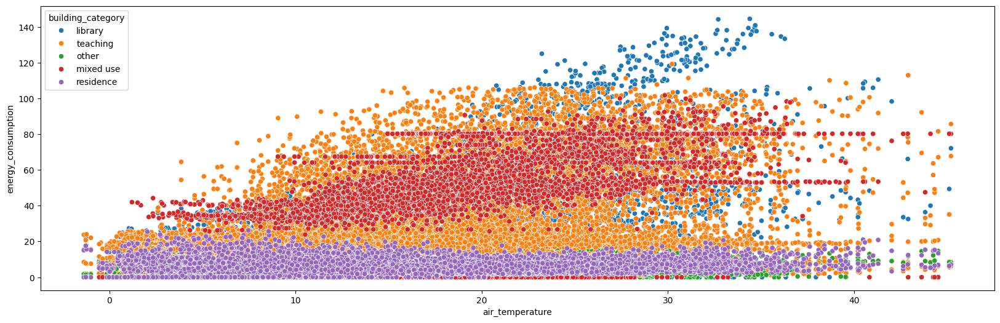

In [12]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="air_temperature",y="energy_consumption",hue="building_category",data=df)

<Axes: xlabel='air_temperature', ylabel='energy_consumption'>

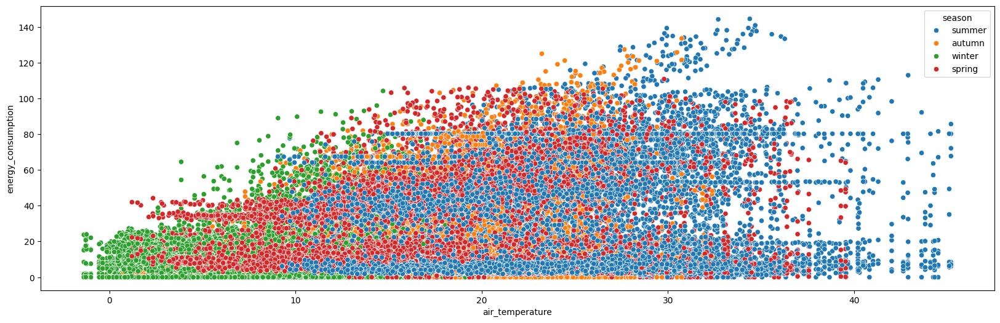

In [13]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="air_temperature",y="energy_consumption",hue="season",data=df)

<Axes: xlabel='air_temperature', ylabel='energy_consumption'>

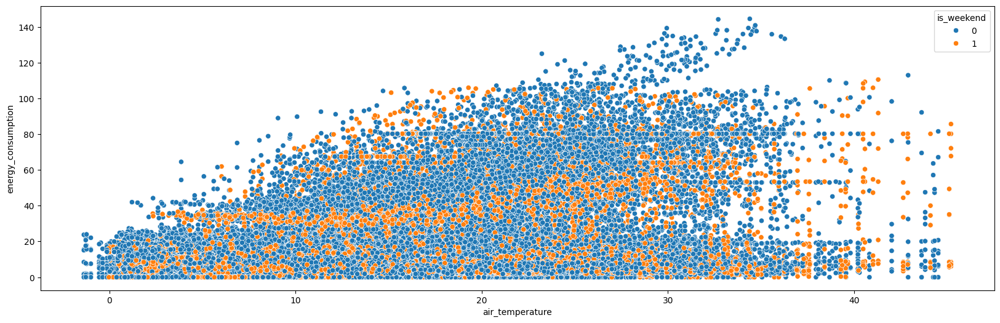

In [14]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="air_temperature",y="energy_consumption",hue="is_weekend",data=df)

<Axes: xlabel='air_temperature', ylabel='energy_consumption'>

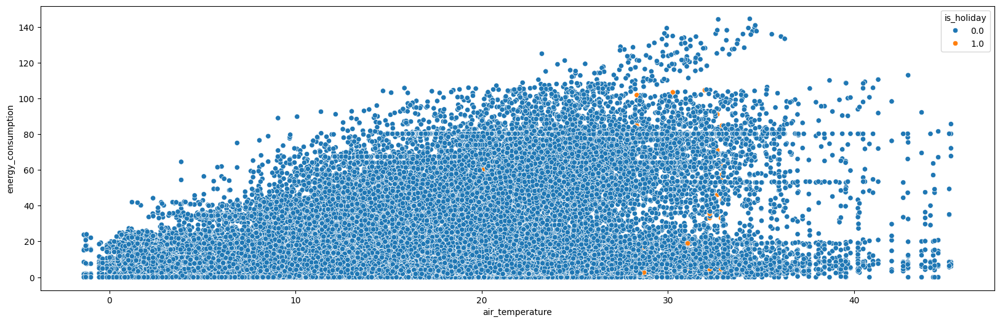

In [15]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="air_temperature",y="energy_consumption",hue="is_holiday",data=df)

## how apparent temperatue affects the consumption

<Axes: xlabel='apparent_temperature', ylabel='energy_consumption'>

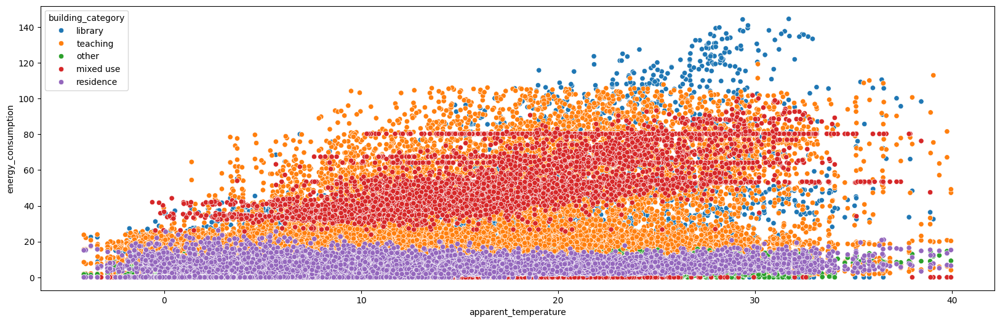

In [16]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="apparent_temperature",y="energy_consumption",hue="building_category",data=df)

<Axes: xlabel='apparent_temperature', ylabel='energy_consumption'>

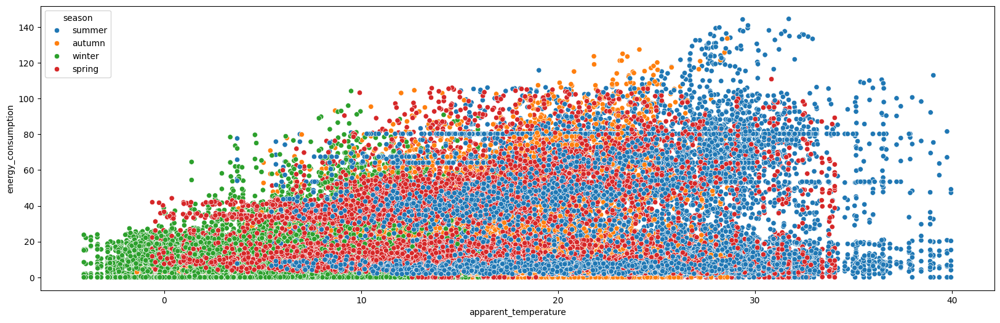

In [17]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="apparent_temperature",y="energy_consumption",hue="season",data=df)

<Axes: xlabel='apparent_temperature', ylabel='energy_consumption'>

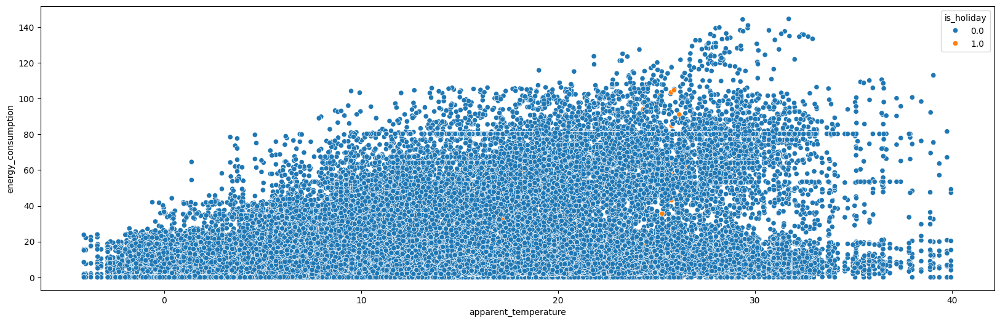

In [18]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="apparent_temperature",y="energy_consumption",hue="is_holiday",data=df)

<Axes: xlabel='apparent_temperature', ylabel='energy_consumption'>

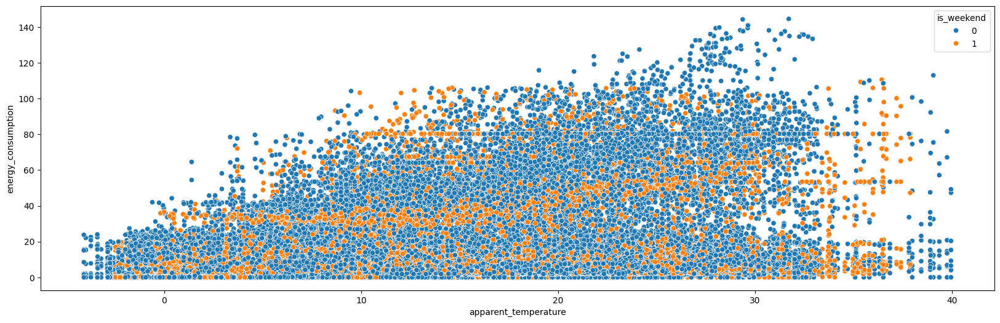

In [19]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="apparent_temperature",y="energy_consumption",hue="is_weekend",data=df)

## how dew_point_temperature affects the consumption

<Axes: xlabel='dew_point_temperature', ylabel='energy_consumption'>

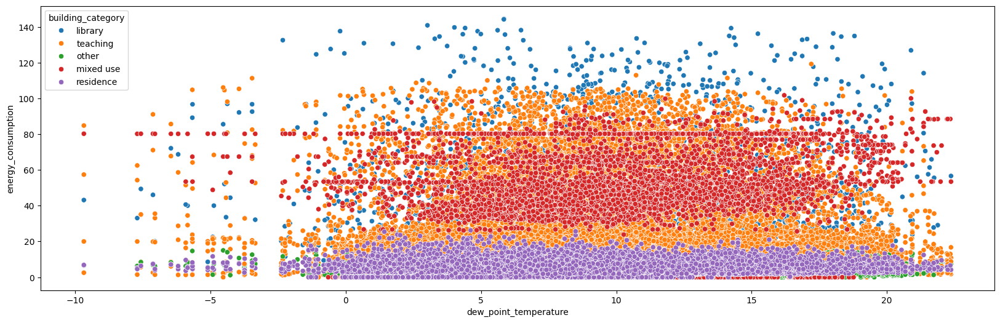

In [20]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="dew_point_temperature",y="energy_consumption",hue="building_category",data=df)

<Axes: xlabel='dew_point_temperature', ylabel='energy_consumption'>

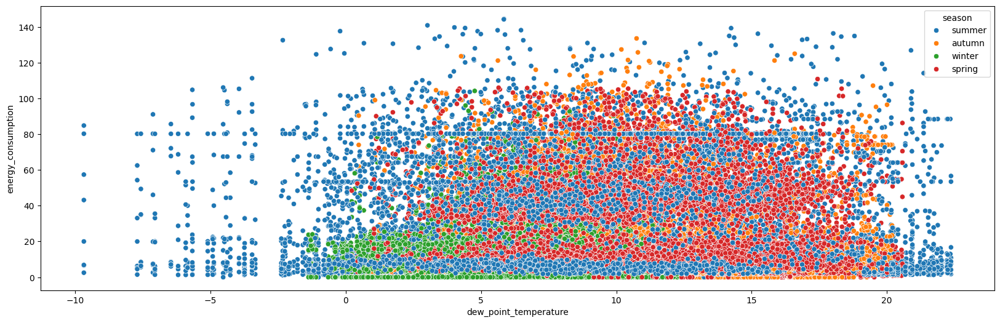

In [21]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="dew_point_temperature",y="energy_consumption",hue="season",data=df)

<Axes: xlabel='dew_point_temperature', ylabel='energy_consumption'>

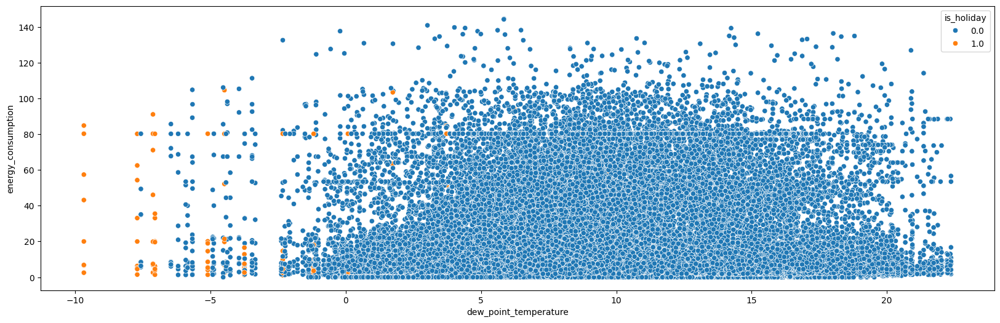

In [22]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="dew_point_temperature",y="energy_consumption",hue="is_holiday",data=df)

<Axes: xlabel='dew_point_temperature', ylabel='energy_consumption'>

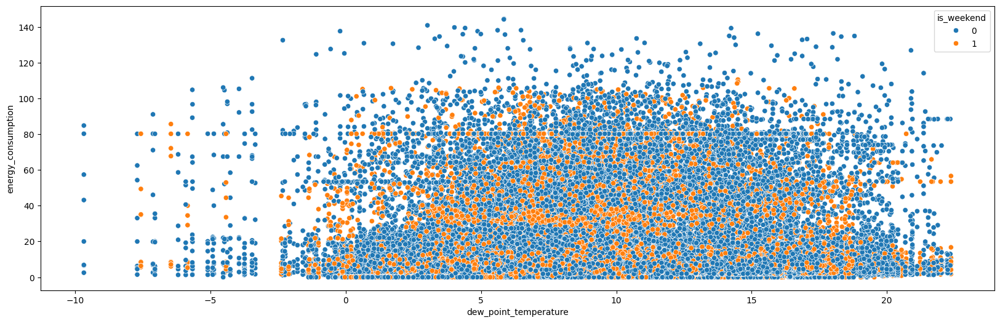

In [23]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="dew_point_temperature",y="energy_consumption",hue="is_weekend",data=df)

<Axes: xlabel='dew_point_temperature', ylabel='energy_consumption'>

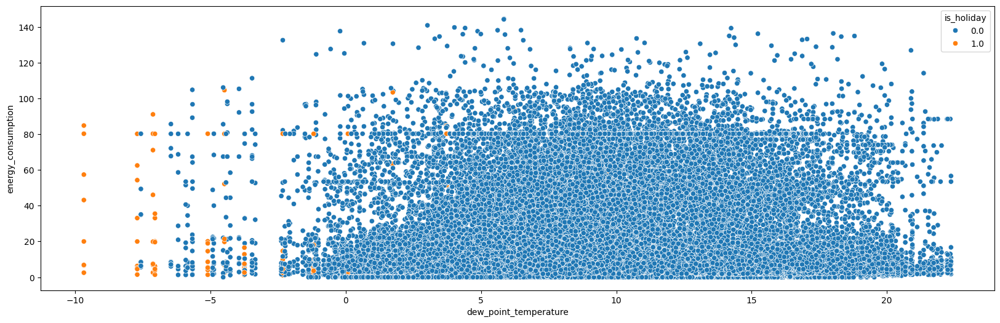

In [24]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="dew_point_temperature",y="energy_consumption",hue="is_holiday",data=df)

## how relative humidity affects the energy consumption

<Axes: xlabel='relative_humidity', ylabel='energy_consumption'>

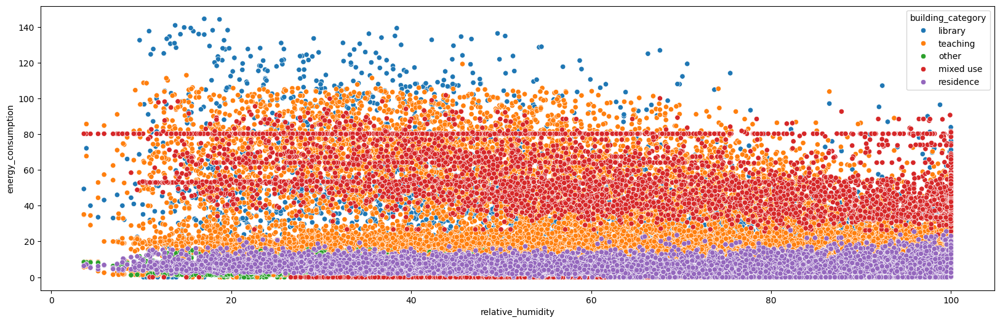

In [25]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="relative_humidity",y="energy_consumption",hue="building_category",data=df)

<Axes: xlabel='relative_humidity', ylabel='energy_consumption'>

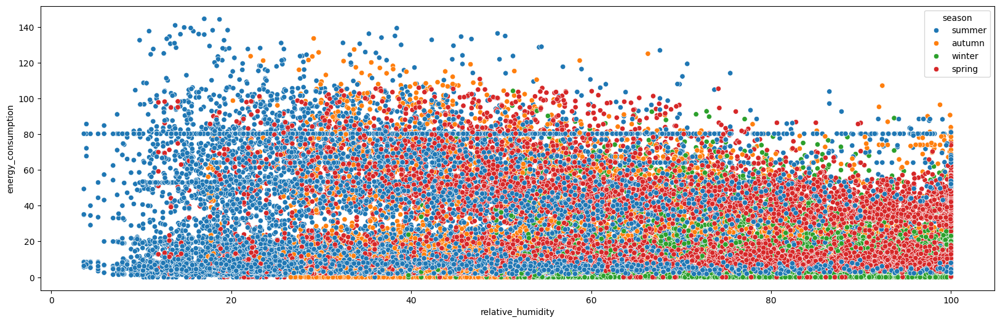

In [26]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="relative_humidity",y="energy_consumption",hue="season",data=df)

<Axes: xlabel='relative_humidity', ylabel='energy_consumption'>

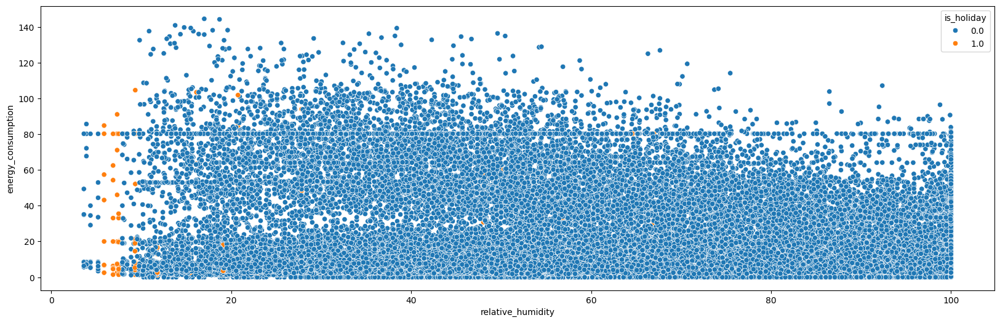

In [27]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="relative_humidity",y="energy_consumption",hue="is_holiday",data=df)

<Axes: xlabel='relative_humidity', ylabel='energy_consumption'>

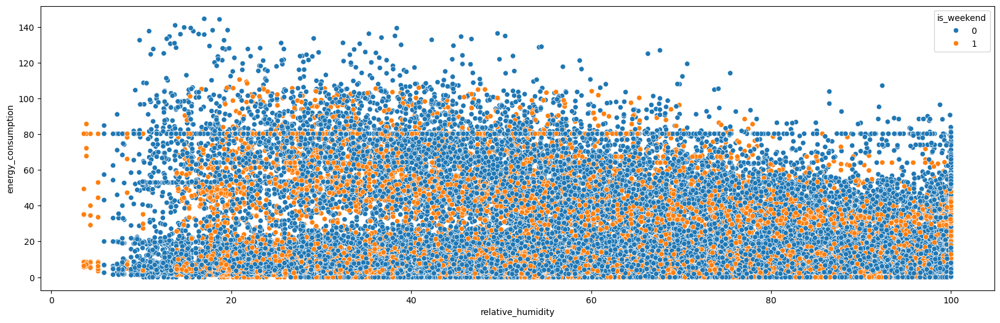

In [28]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="relative_humidity",y="energy_consumption",hue="is_weekend",data=df)

## how does wind speed affect the energy consumption

<Axes: xlabel='wind_speed', ylabel='energy_consumption'>

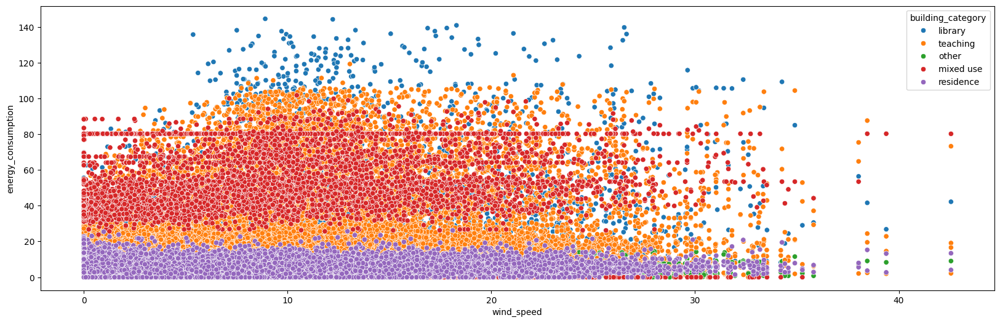

In [29]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="wind_speed",y="energy_consumption",hue="building_category",data=df)

<Axes: xlabel='wind_speed', ylabel='energy_consumption'>

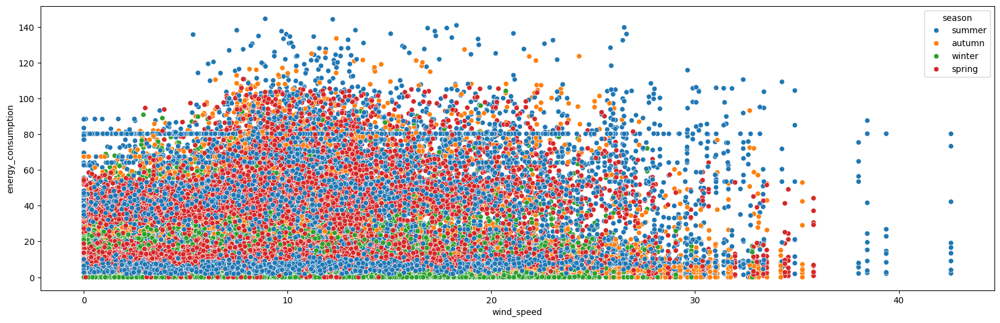

In [30]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="wind_speed",y="energy_consumption",hue="season",data=df)

<Axes: xlabel='wind_speed', ylabel='energy_consumption'>

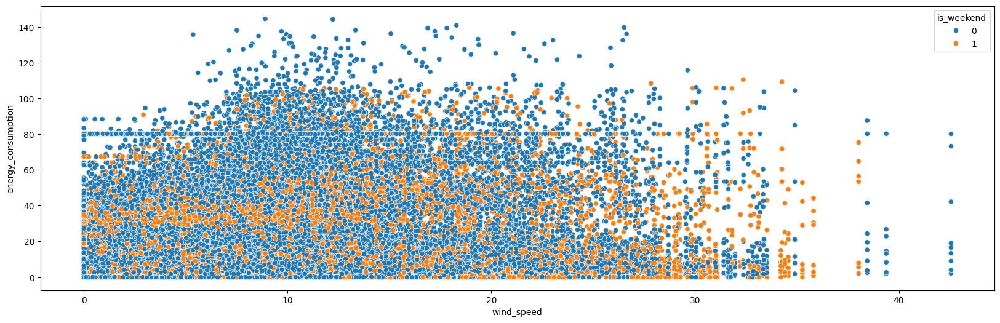

In [31]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="wind_speed",y="energy_consumption",hue="is_weekend",data=df)

<Axes: xlabel='wind_speed', ylabel='energy_consumption'>

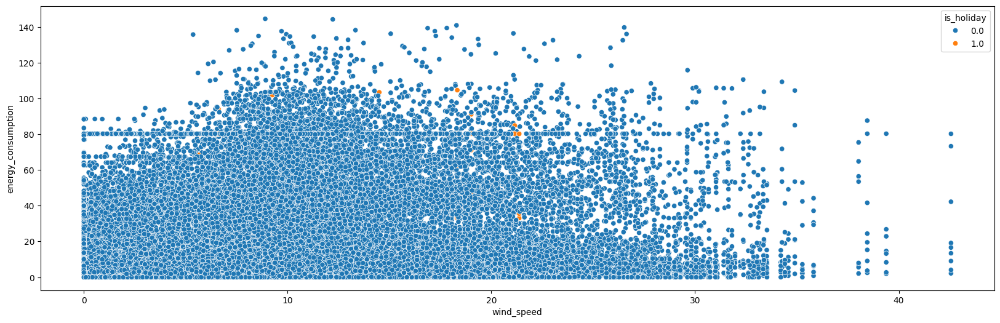

In [32]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="wind_speed",y="energy_consumption",hue="is_holiday",data=df)

## how wind direction affects the energy_consumption

<Axes: xlabel='wind_direction', ylabel='energy_consumption'>

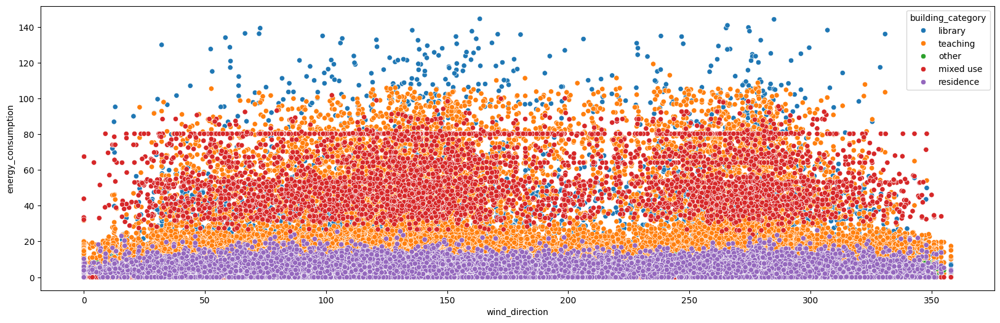

In [33]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="wind_direction",y="energy_consumption",hue="building_category",data=df)

<Axes: xlabel='wind_direction', ylabel='energy_consumption'>

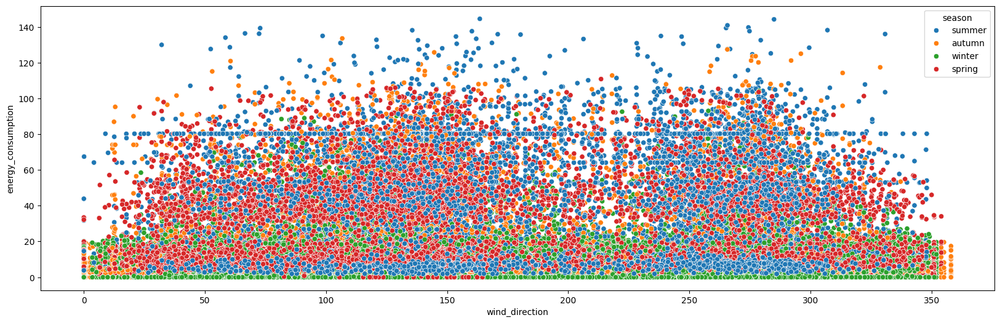

In [34]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="wind_direction",y="energy_consumption",hue="season",data=df)

<Axes: xlabel='wind_direction', ylabel='energy_consumption'>

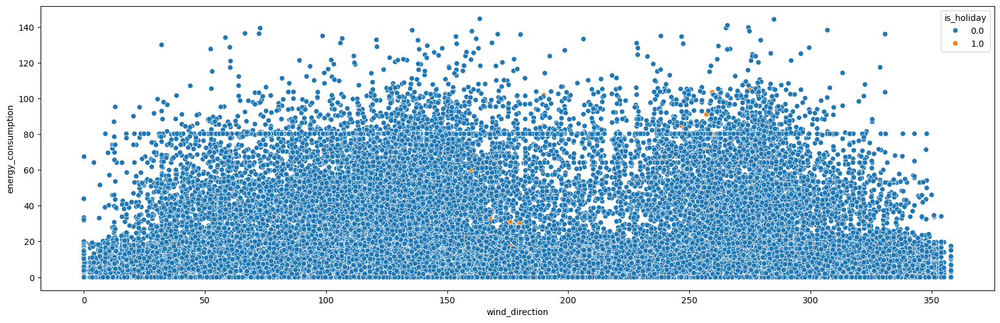

In [35]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="wind_direction",y="energy_consumption",hue="is_holiday",data=df)

<Axes: xlabel='wind_direction', ylabel='energy_consumption'>

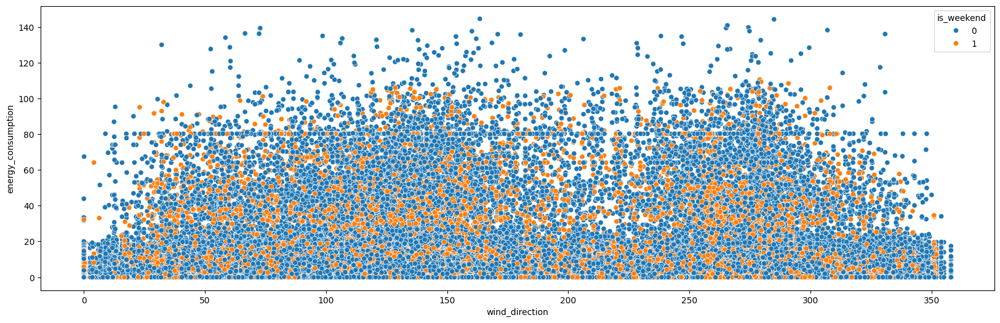

In [36]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="wind_direction",y="energy_consumption",hue="is_weekend",data=df)

<Axes: xlabel='wind_direction', ylabel='energy_consumption'>

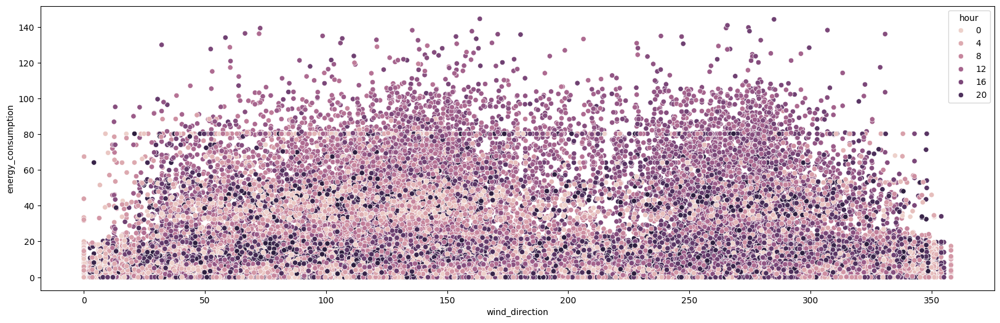

In [37]:
plt.figure(figsize=(20,6))
sns.scatterplot(x="wind_direction",y="energy_consumption",hue="hour",data=df)

<Axes: xlabel='month', ylabel='energy_consumption'>

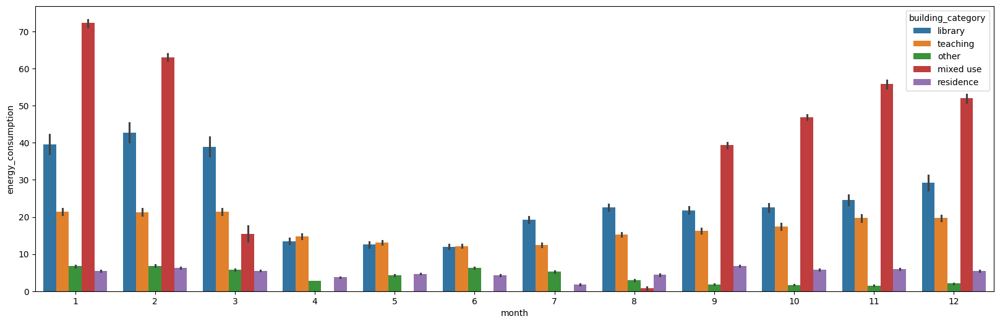

In [39]:
plt.figure(figsize=(20,6))
sns.barplot(x="month",y="energy_consumption",hue="building_category",data=df)